<h3>Checkpoint Objective</h3>
In this checkpoint, we are going to work on the 'Financial Inclusion in Africa' dataset that was provided as part of the Financial Inclusion in Africa hosted by the Zindi platform.

Dataset description: The dataset contains demographic information and what financial services are used by approximately 33,600 individuals across East Africa. The ML model role is to predict which individuals are most likely to have or use a bank account.

The term financial inclusion means:  individuals and businesses have access to useful and affordable financial products and services that meet their needs – transactions, payments, savings, credit and insurance – delivered in a responsible and sustainable way.

<h3>Instructions</h3>
<ol><li>Install the necessary packages</li>
<li>Import you data and perform basic data exploration phase</li>
<ul><li>Display general information about the dataset</li>
<li>Create a pandas profiling reports to gain insights into the dataset</li>
<li>Handle Missing and corrupted values</li>
<li>Remove duplicates, if they exist</li>
<li>Handle outliers, if they exist</li>
<li>Encode categorical features</li></ul>
<li>Based on the previous data exploration train and test a machine learning classifier</li>
<li>Create a streamlit application (locally) and add input fields for your features and a validation button at the end of the form</li>
<li>Import your ML model into the streamlit application and start making predictions given the provided features values</li>
<li>Deploy your application on Streamlit share:</li>
<ul><li>Create a github and a streamlit share accounts</li>
<li>Create a new git repo</li>
<li>Upload your local code to the newly created git repo</li>
<li>log in to your streamlit account an deploy your application from the git repo</li></ul></ol>

In [45]:
%pip install pandas
%pip install matplotlib
%pip install seaborn
%pip install scikit-learn

Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.


In [46]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import warnings
warnings.filterwarnings
import seaborn as sns
from sklearn.preprocessing import StandardScaler, LabelEncoder


Introduction

One of the significant challenges facing Africa, with far-reaching impacts on both human development and the economy, revolves around the issue of banking accessibility, whether for personal or commercial purposes. In a diverse population of approximately 172.19 million people across four countries (according to The World Bank Group, 2020), only a mere 14% of the adult population, equivalent to 9.1 million individuals (as reported by Zindi), currently enjoy this privilege.

This problem is further exacerbated when the measure of banking access serves as the foundational metric for assessing financial inclusion. Access to banks opens up numerous advantages for those fortunate enough to possess it, including the potential for credit, financing, and related financial services.

Hence, this checkpoint aims to develop a model that predicts the likelihood of individuals having or using a bank account, addressing this critical issue of financial inclusion.

In [47]:
data = pd.read_csv('dataset\Financial_inclusion_dataset.csv')
data.head(4)

,country,year,uniqueid,bank_account,location_type,cellphone_access,household_size,age_of_respondent,gender_of_respondent,relationship_with_head,marital_status,education_level,job_type
0,Kenya,2018,uniqueid_1,Yes,Rural,Yes,3,24,Female,Spouse,Married/Living together,Secondary education,Self employed
1,Kenya,2018,uniqueid_2,No,Rural,No,5,70,Female,Head of Household,Widowed,No formal education,Government Dependent
2,Kenya,2018,uniqueid_3,Yes,Urban,Yes,5,26,Male,Other relative,Single/Never Married,Vocational/Specialised training,Self employed
3,Kenya,2018,uniqueid_4,No,Rural,Yes,5,34,Female,Head of Household,Married/Living together,Primary education,Formally employed Private


In [71]:
data['location_type'].value_counts()

location_type
Rural    14343
Urban     9181
Name: count, dtype: int64

In [48]:
r = data['age_of_respondent'].value_counts()
pd.set_option('display.max_rows', None)
r

age_of_respondent
30     1056
35      836
25      792
28      748
32      715
40      685
20      626
26      615
23      588
18      585
27      570
22      568
45      564
24      562
38      554
33      527
34      522
29      517
17      477
21      471
19      470
31      467
16      462
36      460
42      450
50      448
37      434
39      374
43      371
60      364
48      322
41      315
47      300
55      297
65      293
52      279
70      275
46      264
49      260
44      254
53      253
56      250
54      234
51      214
58      206
57      189
59      171
63      168
75      149
62      143
61      139
68      130
64      129
67      125
80      124
66      120
72       97
71       95
73       92
69       87
78       83
76       72
74       64
79       58
77       56
85       55
82       41
83       33
90       28
86       25
88       24
81       24
84       20
95       19
89       16
87       16
92        7
98        6
94        5
91        5
100       5
93        

In [49]:
df = data.copy()
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23524 entries, 0 to 23523
Data columns (total 13 columns):
 #   Column                  Non-Null Count  Dtype 
---  ------                  --------------  ----- 
 0   country                 23524 non-null  object
 1   year                    23524 non-null  int64 
 2   uniqueid                23524 non-null  object
 3   bank_account            23524 non-null  object
 4   location_type           23524 non-null  object
 5   cellphone_access        23524 non-null  object
 6   household_size          23524 non-null  int64 
 7   age_of_respondent       23524 non-null  int64 
 8   gender_of_respondent    23524 non-null  object
 9   relationship_with_head  23524 non-null  object
 10  marital_status          23524 non-null  object
 11  education_level         23524 non-null  object
 12  job_type                23524 non-null  object
dtypes: int64(3), object(10)
memory usage: 2.3+ MB


In [50]:
df.shape

(23524, 13)

In [51]:
df.isnull().sum()

country                   0
year                      0
uniqueid                  0
bank_account              0
location_type             0
cellphone_access          0
household_size            0
age_of_respondent         0
gender_of_respondent      0
relationship_with_head    0
marital_status            0
education_level           0
job_type                  0
dtype: int64

In [52]:
df.duplicated().any()

False

In [53]:
cat = df.select_dtypes(include = ['category', 'object'])
num = df.select_dtypes(include = 'number')
display(cat.head())
display(num.head())

,country,uniqueid,bank_account,location_type,cellphone_access,gender_of_respondent,relationship_with_head,marital_status,education_level,job_type
0,Kenya,uniqueid_1,Yes,Rural,Yes,Female,Spouse,Married/Living together,Secondary education,Self employed
1,Kenya,uniqueid_2,No,Rural,No,Female,Head of Household,Widowed,No formal education,Government Dependent
2,Kenya,uniqueid_3,Yes,Urban,Yes,Male,Other relative,Single/Never Married,Vocational/Specialised training,Self employed
3,Kenya,uniqueid_4,No,Rural,Yes,Female,Head of Household,Married/Living together,Primary education,Formally employed Private
4,Kenya,uniqueid_5,No,Urban,No,Male,Child,Single/Never Married,Primary education,Informally employed


,year,household_size,age_of_respondent
0,2018,3,24
1,2018,5,70
2,2018,5,26
3,2018,5,34
4,2018,8,26


C:\Users\USER\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\USER\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
C:\Users\USER\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) ins

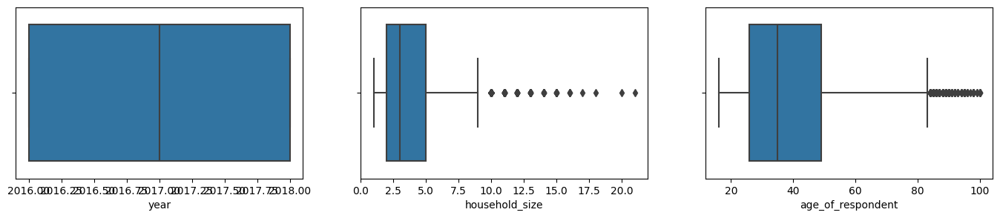

In [54]:
import matplotlib.pyplot as plt
import seaborn as sns

def OutlierChecker(dataframe, a, b, c):
    plt.figure(figsize=(17, 3))

    plt.subplot(1, 3, 1)
    sns.boxplot(x=dataframe[a])

    plt.subplot(1, 3, 2)
    sns.boxplot(x=dataframe[b])

    plt.subplot(1, 3, 3)
    sns.boxplot(x=dataframe[c])

OutlierChecker(df, 'year', 'household_size' , 'age_of_respondent')

In [55]:
def outlierRemoval(dataframe):
    for i in dataframe.columns:
      if i in dataframe.select_dtypes(include = 'number').columns:
          Q1 = dataframe[i].describe()[4]  # Index 3 for Q1 (25th percentile)
          Q3 = dataframe[i].describe()[6]  # Index 7 for Q3 (75th percentile)
          IQR = Q3 - Q1
          lowerIQR = Q1 - 1.5 * IQR
          upperIQR = Q3 + 1.5 * IQR
          dataframe = dataframe.loc[(dataframe[i] >= lowerIQR) & (dataframe[i] <= upperIQR)]
    return dataframe

outlierRemoval(df)

C:\Users\USER\AppData\Local\Temp\ipykernel_8212\188580662.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  Q1 = dataframe[i].describe()[4]  # Index 3 for Q1 (25th percentile)
C:\Users\USER\AppData\Local\Temp\ipykernel_8212\188580662.py:5: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  Q3 = dataframe[i].describe()[6]  # Index 7 for Q3 (75th percentile)
C:\Users\USER\AppData\Local\Temp\ipykernel_8212\188580662.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by po

,country,year,uniqueid,bank_account,location_type,cellphone_access,household_size,age_of_respondent,gender_of_respondent,relationship_with_head,marital_status,education_level,job_type
0,Kenya,2018,uniqueid_1,Yes,Rural,Yes,3,24,Female,Spouse,Married/Living together,Secondary education,Self employed
1,Kenya,2018,uniqueid_2,No,Rural,No,5,70,Female,Head of Household,Widowed,No formal education,Government Dependent
2,Kenya,2018,uniqueid_3,Yes,Urban,Yes,5,26,Male,Other relative,Single/Never Married,Vocational/Specialised training,Self employed
3,Kenya,2018,uniqueid_4,No,Rural,Yes,5,34,Female,Head of Household,Married/Living together,Primary education,Formally employed Private
4,Kenya,2018,uniqueid_5,No,Urban,No,8,26,Male,Child,Single/Never Married,Primary education,Informally employed
5,Kenya,2018,uniqueid_6,No,Rural,No,7,26,Female,Spouse,Married/Living together,Primary education,Informally employed
6,Kenya,2018,uniqueid_7,No,Rural,Yes,7,32,Female,Spouse,Married/Living together,Primary education,Self employed
7,Kenya,2018,uniqueid_8,No,Rural,Yes,1,42,Female,Head of Household,Married/Living together,Tertiary education,Formally employed Government
8,Kenya,2018,uniqueid_9,Yes,Rural,Yes,3,54,Male,Head of Household,Married/Living together,Secondary education,Farming and Fishing
9,Kenya,2018,uniqueid_10,No,Urban,Yes,3,76,Female,Head of Household,Divorced/Seperated,No formal education,Remittance Dependent


In [56]:
# Assuming 'Yes' should be mapped to 1 and 'No' to 0
df['bank_account'] = df['bank_account'].map({'Yes': 1, 'No': 0})

In [57]:
df['bank_account'].head(4)

0    1
1    0
2    1
3    0
Name: bank_account, dtype: int64

In [58]:
X= df[['country', 'year', 'uniqueid', 'location_type',	'cellphone_access',
      'household_size',	'age_of_respondent', 'gender_of_respondent', 'relationship_with_head',
      'marital_status',	'education_level', 'job_type']]
Y = df['bank_account']

In [59]:
from sklearn.preprocessing import StandardScaler, LabelEncoder

def transformer(dataframe):
    lb = LabelEncoder()
    scaler = StandardScaler()

    dep = dataframe.drop('bank_account', axis=1)

    for i in dep.columns:
        if i in dataframe.select_dtypes(include='number').columns:
            # Scale only numerical columns
            dataframe[[i]] = scaler.fit_transform(dataframe[[i]])
        elif i in dataframe.select_dtypes(include=['object', 'category']).columns:
            # Label encode categorical columns
            dataframe[i] = lb.fit_transform(dataframe[i])

    return dataframe


transformer(df)

,country,year,uniqueid,bank_account,location_type,cellphone_access,household_size,age_of_respondent,gender_of_respondent,relationship_with_head,marital_status,education_level,job_type
0,0,1.208541,0,1,0,1,-0.358007,-0.896188,0,5,2,3,9
1,0,1.208541,1111,0,0,0,0.539834,1.888279,0,1,4,0,4
2,0,1.208541,2222,1,1,1,0.539834,-0.775124,1,3,3,5,9
3,0,1.208541,3333,0,0,1,0.539834,-0.290869,0,1,2,2,3
4,0,1.208541,4444,0,1,0,1.886596,-0.775124,1,0,3,2,5
5,0,1.208541,5555,0,0,0,1.437676,-0.775124,0,5,2,2,5
6,0,1.208541,6666,0,0,1,1.437676,-0.411933,0,5,2,2,9
7,0,1.208541,7777,0,0,1,-1.255848,0.193386,0,1,2,4,2
8,0,1.208541,8624,1,0,1,-0.358007,0.919769,1,1,2,3,1
9,0,1.208541,1,0,1,1,-0.358007,2.251470,0,1,0,0,8


In [60]:
#%pip install xgboost

C:\Users\USER\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:335: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(dtype):
C:\Users\USER\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:338: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  is_categorical_dtype(dtype) or is_pa_ext_categorical_dtype(dtype)
C:\Users\USER\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\xgboost\data.py:384: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if is_categorical_dty

<Axes: title={'center': 'Feature importance'}, xlabel='F score', ylabel='Features'>

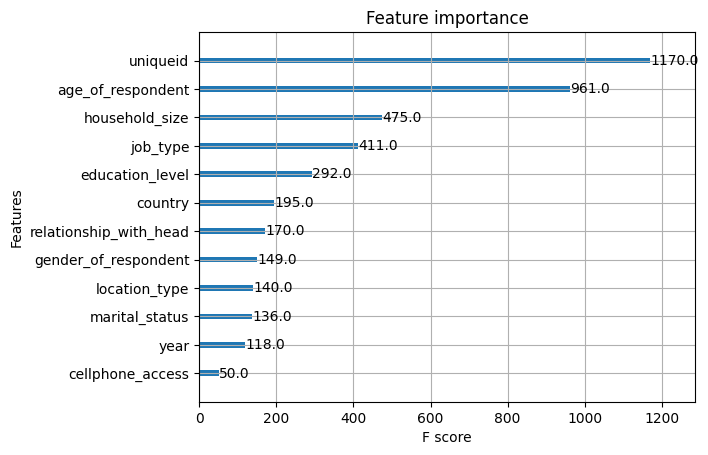

In [61]:
import xgboost as xgb

X = df.drop('bank_account', axis=1)
Y = df.bank_account

# Create and train an XGBoost model
model = xgb.XGBClassifier()
model.fit(X, Y)

# # Now, you can access the booster from the trained model and plot feature importance
# booster = model.get_booster()
# xgb.plot_importance(booster)
# plt.rcParams['figure.figsize'] = (5, 13)
# # Print feature importance scores
# xgb.plot_importance(model, importance_type= 'weight')
# plt.show()

# Print feature importance scores
xgb.plot_importance(model)

In [62]:
# ANOVA F-value between label/feature

from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import f_classif

best_feature1 = SelectKBest(score_func = f_classif, k = 'all')
fitting1 = best_feature1.fit(X,Y)
scores1 = pd.DataFrame(fitting1.scores_)
columns1 = pd.DataFrame(X.columns)
feat_score1 = pd.concat([columns1, scores1], axis = 1)
feat_score1.columns = ['Feature', 'F_classif_score']
k1 = feat_score1.nlargest(10, 'F_classif_score')
k1.reset_index(drop = True, inplace = True)

k1.sort_values(by = 'F_classif_score', ascending = False)

,Feature,F_classif_score
0,education_level,2754.442133
1,cellphone_access,1081.598580
2,country,628.835013
3,gender_of_respondent,327.786325
4,year,300.529753
5,location_type,180.595902
6,relationship_with_head,118.679875
7,job_type,97.262178
8,marital_status,35.352281
9,household_size,18.888950


In [72]:
x = df[['gender_of_respondent', 'age_of_respondent', 'country', 'job_type',
         'education_level', 'location_type', 'cellphone_access']]

y = df.bank_account

In [73]:
#split into train and test
from sklearn.model_selection import train_test_split

xtrain,xtest,ytrain,ytest = train_test_split(x, y, test_size = 0.20, random_state = 42, stratify = y)

display(xtrain.shape)
display(xtest.shape)
display(ytrain.shape)
display(ytest.shape)

(18819, 7)

(4705, 7)

(18819,)

(4705,)

In [74]:
train_set = pd.concat([xtrain, ytrain], axis = 1)
test_set = pd.concat([xtest, ytest], axis = 1)

print('Train Set')
display(train_set.head())
print(f"\t\t{train_set.shape}\n\n")

print('Test Set')
display(test_set.head())
print(f"\t\t{test_set.shape}\n\n")

Train Set


,gender_of_respondent,age_of_respondent,country,job_type,education_level,location_type,cellphone_access,bank_account
3535,0,-0.654060,0,5,2,0,1,0
10836,1,1.464556,1,1,0,0,0,0
23078,0,-0.290869,3,9,3,0,1,0
10569,1,1.040833,1,5,2,0,0,0
9135,1,-0.230337,1,1,2,0,1,0


		(18819, 8)


Test Set


,gender_of_respondent,age_of_respondent,country,job_type,education_level,location_type,cellphone_access,bank_account
69,1,-0.532997,0,3,3,1,1,1
13395,0,-0.532997,1,8,2,1,1,0
18888,0,-0.290869,2,9,0,1,1,0
4660,0,0.374982,0,5,2,0,0,0
13090,0,-0.230337,1,1,2,0,1,0


		(4705, 8)




In [75]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report
from sklearn.metrics import accuracy_score

 #create a RandomForestClassifirer instance
forestclas_Model = RandomForestClassifier(criterion = "gini", max_depth=8, min_samples_split= 10, random_state= 42)

# #  fit the model to the training data
forestclas_Model.fit(xtrain, ytrain)

# make predictions on the training data
train_pred = forestclas_Model.predict(xtrain)

# Calculate accuracy
accuracy = accuracy_score(ytrain, train_pred)
print(f"Accuracy: {accuracy:.2f}")

Accuracy: 0.89


In [76]:
# print classification report
print(classification_report(ytrain, train_pred))

              precision    recall  f1-score   support

           0       0.90      0.99      0.94     16169
           1       0.79      0.31      0.45      2650

    accuracy                           0.89     18819
   macro avg       0.84      0.65      0.69     18819
weighted avg       0.88      0.89      0.87     18819



In [77]:
# #  fit the model to the test data
forestclas_Model.fit(xtest, ytest)

# make predictions on the test data
test_pred = forestclas_Model.predict(xtest)

# print classification report
print(classification_report(ytest, test_pred))

              precision    recall  f1-score   support

           0       0.90      0.99      0.94      4043
           1       0.82      0.36      0.50       662

    accuracy                           0.90      4705
   macro avg       0.86      0.67      0.72      4705
weighted avg       0.89      0.90      0.88      4705



In [ ]:
import pickle

pickle.dump(forestclas_Model,open('financial_Inc_model.pkl', 'wb'))